## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from dateutil import parser
from sys import getsizeof
import re

import operator
from scipy import stats

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
plt.rcParams['figure.figsize'] = (12.0, 8.0)
plt.rcParams['axes.axisbelow'] = True

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots
init_notebook_mode(True)

from hallprobecalib import hpc_ext_path
from hallprobecalib.hpcplots import scatter2d,scatter3d,histo

In [4]:
plotdir = hpc_ext_path+'plots/hall_probe_stability/2019-08-09/'

In [5]:
pkl_dir = hpc_ext_path+"datafiles/hall_probe_stability/"
pkl_file = "hall_stability.run01.raw.base.pkl"

In [6]:
df = pd.read_pickle(pkl_dir+pkl_file)

## Cleaning

In [92]:
directory = "/home/ckampa/Dropbox/LogFiles/"#hpc_ext_path+'datafiles/magnet_stability/nmr/'
filename = '2019-08-09 163218slow.txt'

In [93]:
df = pd.read_csv(directory+filename)

In [94]:
df_full = pd.read_csv(directory+filename)

In [8]:
#df_ = pd.read_csv(directory+filename)
#df_.tail(1)

In [95]:
df_full.tail(1)

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,...,6A0000000D61333A_Cal_T,C50000000D5E473A_Cal_T,8F0000000D5B373A_Cal_T,Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z,
3652,8/13/2019 11:54:20 AM,256.069034,33.681117,53.71941,51.074944,29.425728,32.634773,30.979216,36.506695,27.646061,...,18.931,17.898,19.161,249952.34375,639878.0,750000.0,1920000.0,750000.0,1920000.0,NaN


In [23]:
#df.describe()

In [96]:
df = df[df[" NMR [T]"] != 0]
#df = df.iloc["2019-07-08 09:30:00":]

In [24]:
#len(df)

In [25]:
#len(df_full)

In [97]:
dates = [parser.parse(row.Time) for row in df.itertuples()]# if isdatetime(row.Time.values[0])]

- NOTE: 'as.type("str")' is necessary to ensure plotly doesn't convert datetime to UTC!
    - **Should not be necessary in updated Plotly package**

In [98]:
df["Datetime"] = pd.to_datetime(dates)#.astype("str")
df = df.set_index("Datetime")

In [99]:
dates = [parser.parse(row.Time) for row in df_full.itertuples()]# if isdatetime(row.Time.values[0])]

- NOTE: 'as.type("str")' is necessary to ensure plotly doesn't convert datetime to UTC!

In [100]:
df_full["Datetime"] = pd.to_datetime(dates)#.astype("str")
df_full = df_full.set_index("Datetime")

In [101]:
primary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df[" NMR [T]"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[('Yoke (center magnet)', -0.9996692190038738),
 (' Yoke', -0.9990908165447533),
 (' 140000000D5FB53A_Cal_T', -0.9780262422315887),
 (' 140000000D5FB53A_Raw_T', -0.9780262422315885),
 (' Floor', -0.9773531766371808),
 (' 6A0000000D61333A_Cal_T', -0.9588880760955387),
 (' 6A0000000D61333A_Raw_T', -0.9588880760955386),
 (' Chamber Wall CH15', -0.9326038512530819),
 (' Chamber Wall CH16', -0.9305243617919033),
 (' Chamber Wall CH14', -0.9270663630204158),
 (' 8E0000000D51483A_Raw_T', -0.9113133489432428),
 (' 8E0000000D51483A_Cal_T', -0.9113133489432419),
 (' 8E0000000D51483A_Raw_Y', -0.9062787605018584),
 (' 8F0000000D5B373A_Raw_T', -0.9015173044881494),
 (' 8F0000000D5B373A_Cal_T', -0.9015173044881486),
 (' Chamber Wall CH18', -0.9011596264153949),
 (' 8E0000000D51483A_Cal_Y', -0.8970816070953888),
 (' C50000000D5E473A_Raw_T', -0.8961492642547845),
 (' C50000000D5E473A_Cal_T', -0.8961492642547829),
 (' Chamber Wall CH17', -0.8823912896450744),
 (' 8E0000000D51483A_Raw_Z', -0.87417316281

In [102]:
# adding in NMR_const
corr_main = "Yoke (center magnet)"
slope, intercept, r_value, p_value, std_err = stats.linregress(df[corr_main], df[" NMR [T]"])
line = slope * df[corr_main] + intercept
df["NMR_const"] = df[" NMR [T]"] - slope * df[corr_main] - intercept + df[" NMR [T]"].mean()

In [103]:
# hall probe stuff

In [104]:
hall_probes = sorted([col for col in df.columns if ("_Raw_" in col) or ("_Cal_" in col)])
main_probe = '8E0000000D51483A'
main_probe_dict = {i: i[-5:] for i in hall_probes if main_probe in i}

df.rename(columns=main_probe_dict, inplace=True)

In [105]:
B_cal = ["Cal_X", "Cal_Y", "Cal_Z"]
B_raw = ["Raw_X", "Raw_Y", "Raw_Z"]

for B, Br in zip(B_cal,B_raw):
    df[f"{B}_Normed"] = df[B] / df[" NMR [T]"]
    df[f"{Br}_Normed"] = df[Br] / df[" NMR [T]"]

df.eval(f"Cal_Mag = (Cal_X**2+Cal_Y**2+Cal_Z**2)**(1/2)", inplace=True)
#df.eval(f"Cal_Mag_Normed = (Cal_X_Normed**2+Cal_Y_Normed**2+Cal_Z_Normed**2)**(1/2)", inplace=True)
df["Cal_Mag_Normed"] = df["Cal_Mag"] / df[" NMR [T]"]
df["Cal_Mag_Res"] = df[" NMR [T]"] - df["Cal_Mag"] # data minus fit
df["Cal_Mag_Res_Rel"] = (df[" NMR [T]"] - df["Cal_Mag"])/(df[" NMR [T]"]) # data minus fit
df.eval(f"Raw_Mag = (Raw_X**2+Raw_Y**2+Raw_Z**2)**(1/2)", inplace=True)
df.eval(f"Raw_Mag_Normed = (Raw_X_Normed**2+Raw_Y_Normed**2+Raw_Z_Normed**2)**(1/2)", inplace=True)
#df["Cal_Mag_Normed2"] = df["Cal_Mag"] / df[" NMR [T]"]

In [106]:
df["Cal_T_Res"] = df[" Hall Element"] - df["Cal_T"] # data minus fit
df["Cal_T_Res_Rel"] = (df[" Hall Element"] - df["Cal_T"])/(df[" Hall Element"]) # data minus fit

### Write out pickle!

In [107]:
df.to_pickle("/home/ckampa/Coding/hallprobecalib_extras/datafiles/hall_probe_stability/hall_stability.run01.raw.base.pkl")

## Plots

In [8]:
fig = histo(df[' NMR [T]'],bins=50,yscale='linear',inline=True);

In [9]:
fname = 'hist_NMR'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html',auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/hist_NMR.html'

In [21]:
#df = df.loc["2019-08-07 09:30:00":]

In [10]:
fig = scatter2d(df_full.index,df_full[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)

NameError: name 'df_full' is not defined

In [20]:
pio.write_image(fig, plotdir+'NMR_vs_Time_full.pdf')
pio.write_image(fig, plotdir+'NMR_vs_Time_full.png')
plot(fig, filename=plotdir+'NMR_vs_Time_full.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/NMR_vs_Time_full.html'

In [21]:
#fig = scatter2d(df_full.index,df_full[" Magnet Current [A]"], lines=True,markers=False,size_list=[6], inline=True)
fig = scatter2d(df_full.index,df_full[" NMR [T]"], lines=True,markers=False,size_list=[6], inline=True)

In [11]:
fig = histo(df[" NMR [T]"], xlabel="NMR [T]", bins=50, yscale='log', autobin=False,horizontal=True, inline=True)

In [12]:
fig = histo(df[" NMR [T]"], xlabel="NMR [T]", bins=50, autobin=False, yscale='log', horizontal=False, inline=True)

In [13]:
fig = scatter2d(df.index,df[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)

In [14]:
nmr =df[' NMR [T]']
(nmr.max() - nmr.min()) / nmr.mean()

0.0011226890730007973

In [15]:
pio.write_image(fig, plotdir+'NMR_vs_Time.pdf')
pio.write_image(fig, plotdir+'NMR_vs_Time.png')
plot(fig, filename=plotdir+'NMR_vs_Time.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/NMR_vs_Time.html'

In [16]:
df.columns

Index(['Time', ' Magnet Current [A]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke',
       ...
       'Cal_Z_Normed', 'Raw_Z_Normed', 'Cal_Mag', 'Cal_Mag_Normed',
       'Cal_Mag_Res', 'Cal_Mag_Res_Rel', 'Raw_Mag', 'Raw_Mag_Normed',
       'Cal_T_Res', 'Cal_T_Res_Rel'],
      dtype='object', length=107)

In [17]:
len(df.columns)

107

In [20]:
temps_ch = [a for a in df.columns if ("CH" in a) and int(a[-2:])<21]# or "HVAC" in a]
temps_ch.append(" Hall Element")
temps_ch.append(" Floor")
temps_ch.append(" Roof")
temps_ch.append(" Yoke")
temps_ch.append("Yoke (center magnet)")
temps_ch.append("Cal_T")

In [21]:
temps_ch

[' Chamber Wall CH13',
 ' Chamber Wall CH14',
 ' Chamber Wall CH15',
 ' Chamber Wall CH16',
 ' Chamber Wall CH17',
 ' Chamber Wall CH18',
 ' Chamber Wall CH19',
 ' Chamber Wall CH20',
 ' Hall Element',
 ' Floor',
 ' Roof',
 ' Yoke',
 'Yoke (center magnet)',
 'Cal_T']

In [22]:
df[temps_ch].describe()

,Chamber Wall CH13,Chamber Wall CH14,Chamber Wall CH15,Chamber Wall CH16,Chamber Wall CH17,Chamber Wall CH18,Chamber Wall CH19,Chamber Wall CH20,Hall Element,Floor,Roof,Yoke,Yoke (center magnet),Cal_T
count,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000,3652.000000
mean,14.744215,16.360429,16.720067,16.441163,14.685842,15.129887,14.401740,13.984677,21.859993,18.845840,13.736792,26.951294,24.591701,21.082057
std,0.394539,0.479219,0.483727,0.492798,0.406297,0.423135,0.379474,0.360083,0.846671,0.642340,0.357350,1.875234,1.747497,0.537337
min,13.195170,13.989998,14.206157,14.000250,12.973354,13.170536,13.001338,12.793115,14.842990,14.135193,12.409288,13.254590,12.914959,16.019000
25%,14.753505,16.391303,16.759055,16.483550,14.704401,15.157143,14.416301,13.992864,21.624042,18.921484,13.739890,27.308919,24.947862,21.026000
50%,14.836324,16.481180,16.840359,16.561629,14.781925,15.232035,14.488024,14.064202,21.983180,19.030068,13.815907,27.472010,25.085276,21.194000
75%,14.953428,16.598779,16.957548,16.685870,14.898571,15.345246,14.605019,14.179060,22.331982,19.119098,13.929409,27.586589,25.201794,21.340000
max,15.234133,16.885187,17.208954,16.962448,15.154167,15.595080,14.863499,14.434876,23.367506,19.329313,14.209156,27.703592,25.384813,21.909000


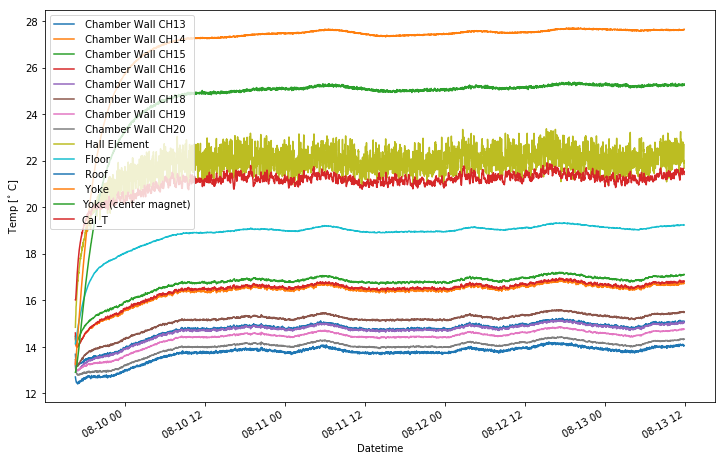

In [23]:
fig = plt.figure()
for c in temps_ch:
    df[c].plot()
#plt.ylabel('Temp [C]')
plt.ylabel("Temp [$^{\circ}$ C]")
plt.legend()    

In [25]:
desk_temps = ["Desk Ambient",' Spare Ambient on desk']
fig = scatter2d([df.index for c in desk_temps], [df[c] for c in desk_temps],inline=True)

In [28]:
res = df[desk_temps[0]] - df[desk_temps[1]]
res = pd.Series(res, name="Desk Temp Residuals (deg C)")
fig = histo(res, bins=30, inline=True)

In [29]:
#fname = 'temps_scatter'
fname = 'hist_desk_temp_residuals'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/hist_desk_temp_residuals.html'

In [26]:
fig = scatter2d([df.index for c in temps_ch],[df[c] for c in temps_ch],inline=True);
fig.layout.title = "Temp vs. Datetime"
fig.layout.yaxis.title = "Temp [deg. C]"

In [27]:
fname = 'temps_scatter'
#fname = 'temps_scatter_full'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/temps_scatter.html'

In [31]:
column = " Chamber Wall CH20"
fig1 = scatter2d(df.index,df[column],show_plot=False,inline=True)
fig2 = histo(df[column],bins=50, autobin=False, horizontal=True,show_plot=False, inline=True)
fig = make_subplots(rows=1, cols=2, column_widths=[0.7, 0.3], shared_yaxes=True)
fig.add_trace(fig1.data[0], row=1, col=1)
fig.add_trace(fig2.data[0], row=1, col=2)

In [32]:
column = " Yoke"
fig1 = scatter2d(df.index,df[column],show_plot=False,inline=True)
fig2 = histo(df[column],bins=50, autobin=False, horizontal=True,show_plot=False, inline=True)
fig = make_subplots(rows=1, cols=2, column_widths=[0.7, 0.3], shared_yaxes=True)
fig.add_trace(fig1.data[0], row=1, col=1)
fig.add_trace(fig2.data[0], row=1, col=2)

In [33]:
fig = scatter2d([df.index for c in temps_ch],[df[c]-(df[c].mean()-df[" Floor"].mean()) for c in temps_ch],inline=True);
fig.layout.title = "Temp vs. Datetime"
fig.layout.yaxis.title = "Temp [deg. C]"

In [34]:
fname = 'temps_scatter_adjusted'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html',auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/temps_scatter_adjusted.html'

In [35]:
fig = histo([df[c]-(df[c].mean()-df[" Floor"].mean()) for c in temps_ch],xlabel="Temperature (deg C)",verbosity=1,opacity=0.6,inline=True);
fig.layout.title = "Temp Histos"

In [36]:
fname = 'hist_temps_adjusted'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html',auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/hist_temps_adjusted.html'

In [37]:
fig = histo([df[c] for c in temps_ch],xlabel="Temperature (deg C)",verbosity=1,inline=True);
fig.layout.title = "Temp Histos"

In [38]:
fname = 'hist_temps'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/hist_temps.html'

In [40]:
#fig = scatter2d(df.index,df[" Yoke"],inline=True);
fig = histo(-df["Yoke (center magnet)"],xlabel="-1 * Temperature (deg C)", bins=50,autobin=False,inline=True);

In [41]:
fname = 'hist_Yoke'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/hist_Yoke.html'

In [42]:
fig = scatter2d([df.index],[df["Desk Ambient"]-df[" Spare Ambient on desk"]],inline=True);

In [43]:
fig.layout.title = "Desk Ambient Residuals vs. Time"
fig.layout.yaxis.title = "Desk Ambient - Spare Ambient on desk (deg C)"
fig.layout.showlegend = False

In [44]:
pio.write_image(fig,plotdir+"Desk_comparison_subtraction.pdf")
pio.write_image(fig,plotdir+"Desk_comparison_subtraction.png")

In [45]:
fig = histo(df["Desk Ambient"],bins=40,autobin=False,inline=True);
pio.write_image(fig,plotdir+"hist_temp_Desk.pdf")
pio.write_image(fig,plotdir+"hist_temp_Desk.png")
fig = histo(df[" Floor"],bins=40,autobin=False,inline=True);
pio.write_image(fig,plotdir+"hist_temp_Floor.pdf")
pio.write_image(fig,plotdir+"hist_temp_Floor.png")

In [46]:
fig = histo(df[" Roof"],bins=50,autobin=False,inline=True);

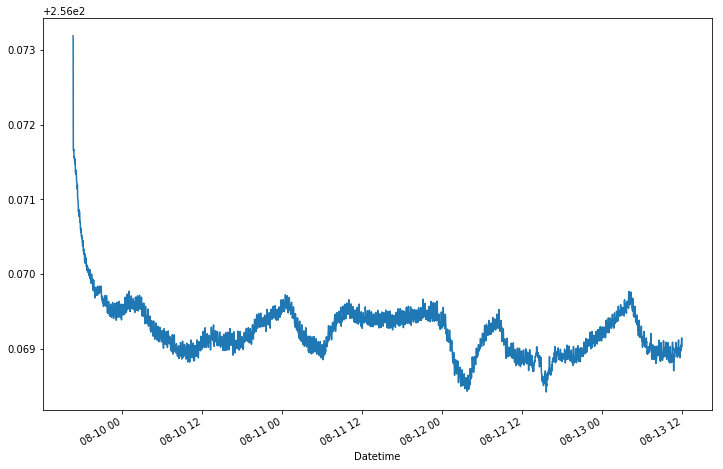

In [47]:
df[' Magnet Current [A]'].plot()

In [48]:
fig = scatter2d(df.index,df[' Magnet Current [A]'],inline=True);

In [49]:
fname = 'magnet_current'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/magnet_current.html'

In [50]:
fig = scatter2d(df.index,df[' Magnet Voltage [V]'],inline=True);

In [51]:
fname = 'magnet_voltage'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html', auto_open=False)

'/home/ckampa/Coding/hallprobecalib_extras/plots/hall_probe_stability/2019-08-09/magnet_voltage.html'

In [52]:
m =df[' Magnet Voltage [V]']
(m.max() - m.min()) / m.mean()

0.09595864797074712

In [53]:
for col in df.columns:
    fig = scatter2d(df.index,df[col],lines=True,markers=False,size_list=[6], show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"time_series/{col}.pdf")
    pio.write_image(fig,plotdir+f"time_series/{col}.png")

In [74]:
'''for col in df_full.columns:
    fig = scatter2d(df_full.index,df_full[col],lines=True,markers=False,size_list=[6], show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"time_series_full/{col}.pdf")
    pio.write_image(fig,plotdir+f"time_series_full/{col}.png")''';

## Correlations

- As seen in past dataset, NMR reading seems inversely correlated to the magnet voltage.
- It also appeared that the voltage was correlated to the water cooling system.
- Let's check if this relationship holds and also try to tease out other correlations.

In [19]:
#import operator
#from scipy import stats

In [27]:
ns = []
for col in df.columns:
    if (df[col].dtype == np.float64) & ("Zab" not in col) & ("NMR [FFT]" not in col) & (col != " "):
        ns.append(col)

In [77]:
len(df.columns)

92

In [78]:
len(ns)

83

In [79]:
df[ns].corr()

,Magnet Current [A],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,Hall Element,...,C50000000D5E473A_Cal_Y,C50000000D5E473A_Cal_Z,8F0000000D5B373A_Cal_X,8F0000000D5B373A_Cal_Y,8F0000000D5B373A_Cal_Z,8E0000000D51483A_Cal_T,140000000D5FB53A_Cal_T,6A0000000D61333A_Cal_T,C50000000D5E473A_Cal_T,8F0000000D5B373A_Cal_T
Magnet Current [A],1.000000,-0.624420,-0.628605,-0.634816,-0.739074,-0.724408,-0.778052,-0.716848,-0.805412,-0.775068,...,0.329298,-0.042901,-0.089715,0.007875,0.125829,-0.834491,-0.803681,-0.794803,-0.785104,-0.802985
Magnet Voltage [V],-0.624420,1.000000,0.997979,0.997323,0.861613,0.936059,0.910861,0.970505,0.648886,0.639227,...,-0.440679,-0.081081,-0.066565,0.245825,-0.213670,0.719752,0.598269,0.555119,0.541598,0.628490
Coil 1 (new),-0.628605,0.997979,1.000000,0.996249,0.859804,0.934295,0.912779,0.968903,0.656086,0.643125,...,-0.444952,-0.073498,-0.061194,0.239794,-0.215566,0.729846,0.610675,0.569317,0.558041,0.643314
Coil 2 (old),-0.634816,0.997323,0.996249,1.000000,0.862578,0.936233,0.913477,0.970917,0.654704,0.667120,...,-0.442102,-0.074360,-0.061636,0.235758,-0.214630,0.736285,0.609813,0.568001,0.559333,0.647361
LCW in Coil1,-0.739074,0.861613,0.859804,0.862578,1.000000,0.984430,0.978952,0.955143,0.830782,0.782398,...,-0.443692,-0.000912,0.028251,0.095976,-0.177637,0.846071,0.793792,0.764049,0.735624,0.789589
LCW out Coil 1,-0.724408,0.936059,0.934295,0.936233,0.984430,1.000000,0.986663,0.990965,0.794185,0.759453,...,-0.455508,-0.029537,-0.004199,0.149650,-0.196200,0.829666,0.750845,0.715391,0.691000,0.759136
LCW in Coil 2,-0.778052,0.910861,0.912779,0.913477,0.978952,0.986663,1.000000,0.978988,0.871642,0.823475,...,-0.466756,0.008384,0.030552,0.103709,-0.193854,0.896814,0.842165,0.812278,0.787637,0.843447
LCW out Coil 2,-0.716848,0.970505,0.968903,0.970917,0.955143,0.990965,0.978988,1.000000,0.776156,0.752421,...,-0.460502,-0.043307,-0.019297,0.177431,-0.204709,0.821808,0.730159,0.691767,0.669352,0.743751
Yoke,-0.805412,0.648886,0.656086,0.654704,0.830782,0.794185,0.871642,0.776156,1.000000,0.888088,...,-0.412018,0.091722,0.135123,-0.061500,-0.135489,0.927352,0.978666,0.961054,0.906054,0.915466
Hall Element,-0.775068,0.639227,0.643125,0.667120,0.782398,0.759453,0.823475,0.752421,0.888088,1.000000,...,-0.387329,0.089471,0.123084,-0.052810,-0.137768,0.909524,0.889764,0.874260,0.859751,0.888809


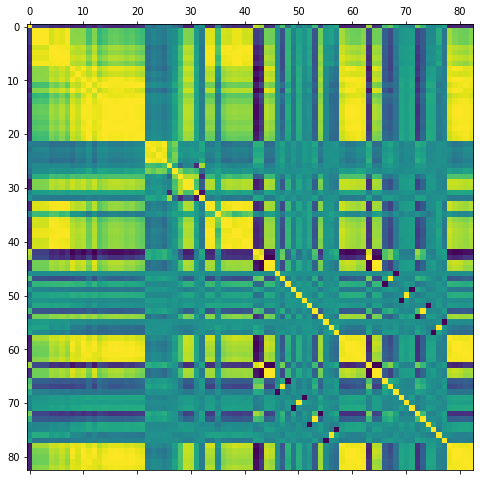

In [80]:
plt.matshow(df[ns].corr())

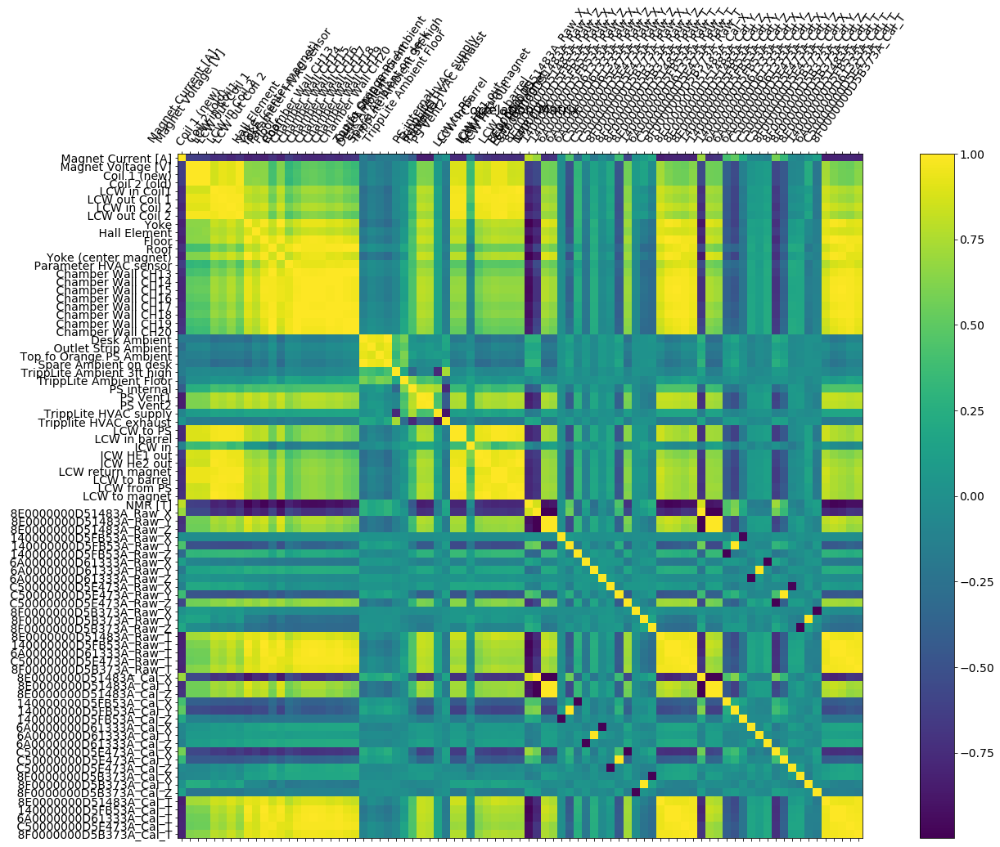

In [81]:
f = plt.figure(figsize=(25, 15))
plt.matshow(df[ns].corr(), fignum=f.number)
plt.xticks(range(df[ns].shape[1]), df[ns].columns, fontsize=14, rotation=55)
plt.yticks(range(df[ns].shape[1]), df[ns].columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

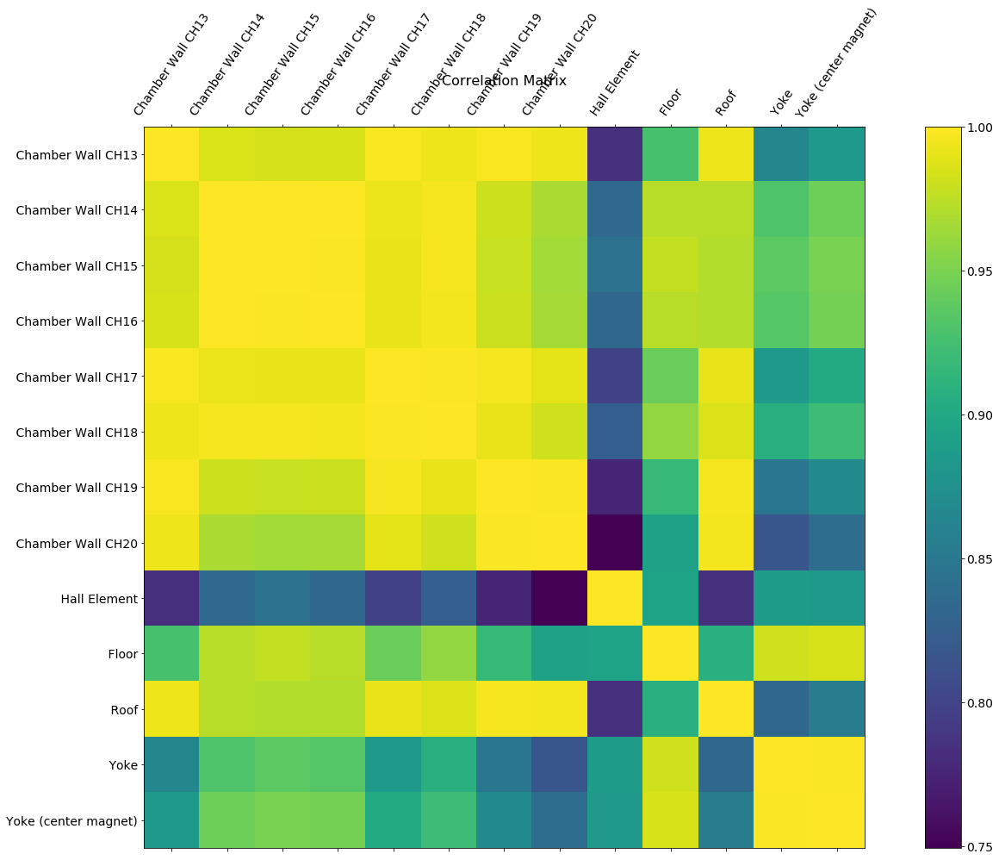

In [82]:
f = plt.figure(figsize=(25, 15))
plt.matshow(df[temps_ch].corr(), fignum=f.number)
plt.xticks(range(df[temps_ch].shape[1]), df[temps_ch].columns, fontsize=14, rotation=55)
plt.yticks(range(df[temps_ch].shape[1]), df[temps_ch].columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [83]:
#corr.style.background_gradient(cmap='coolwarm', axis=None)
#df.corr().style.background_gradient(cmap='coolwarm', axis=None)
df[ns].corr().style.background_gradient(cmap='coolwarm').set_precision(2)

In [28]:
primary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df[" NMR [T]"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[('Yoke (center magnet)', -0.999767956039257),
 (' Yoke', -0.9990636054421388),
 (' Floor', -0.9831911750304733),
 (' 140000000D5FB53A_Cal_T', -0.982932219522837),
 (' 140000000D5FB53A_Raw_T', -0.9829322195228363),
 (' 6A0000000D61333A_Raw_T', -0.9673600323078052),
 (' 6A0000000D61333A_Cal_T', -0.967360032307805),
 (' Chamber Wall CH15', -0.9455616473758031),
 (' Chamber Wall CH16', -0.9432483023758849),
 (' Chamber Wall CH14', -0.9409871503585334),
 (' 8E0000000D51483A_Cal_T', -0.9244955903889853),
 (' 8E0000000D51483A_Raw_T', -0.924495590388985),
 (' 8F0000000D5B373A_Cal_T', -0.918991028829851),
 (' 8F0000000D5B373A_Raw_T', -0.9189910288298503),
 (' Chamber Wall CH18', -0.9171679597780216),
 (' C50000000D5E473A_Raw_T', -0.9141560525031789),
 (' C50000000D5E473A_Cal_T', -0.9141560525031787),
 (' 8E0000000D51483A_Raw_Y', -0.9074921772139715),
 (' Chamber Wall CH17', -0.8980163041562215),
 (' 8E0000000D51483A_Cal_Y', -0.8958843011477021),
 (' Hall Element', -0.8862231692137317),
 (' Cha

Would be helpful to see time as the color to see how this is traced out.

In [85]:
df['ind'] = np.array([i for i in range(len(df))])

In [86]:
def color_scatter2d(x,y,ind,time=df.index,show_plot=True):
    data = [
        go.Scatter(
            x=x,
            y=y,
            marker=dict(
                size=2,
                cmax=ind.max(),
                cmin=ind.min(),
                color=ind,
                colorbar=dict(
                    title='time (index)',
                    #ticktext=df.index
                ),
                colorscale='Viridis',
            ),
            mode='markers',
            text=time,
        )
    ]
    
    layout = go.Layout(
        title = f"{y.name} vs. {x.name}",
        xaxis = dict(
            title = f"{x.name}"
        ),
        yaxis = dict(
            title = f"{y.name}"
        ),
    )

    fig = go.Figure(data=data,layout=layout)
    if show_plot:
        iplot(fig)
    return fig

In [88]:
for col in df.columns:
    fig = color_scatter2d(df[col],df[" NMR [T]"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.png")

In [90]:
fig = color_scatter2d(df["Yoke (center magnet)"],df[" NMR [T]"],df.ind,show_plot=True);

In [29]:
#corr_main = " LCW in barrel"
#corr_main = " Yoke"
corr_main = "Yoke (center magnet)"
#corr_main = " Floor"

filestart = corr_main.strip().lower()

#slope, intercept, r_value, p_value, std_err = stats.linregress(df[" Yoke"], df[" NMR [T]"])
slope, intercept, r_value, p_value, std_err = stats.linregress(df[corr_main], df[" NMR [T]"])

In [30]:
slope, intercept, r_value, p_value, std_err

(-0.00011184289898392875,
 1.2521198804417673,
 -0.999767956039257,
 0.0,
 4.661931770629969e-08)

In [31]:
line = slope * df[corr_main] + intercept

In [32]:
fig = scatter2d(2*[df[corr_main]],[df[" NMR [T]"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [95]:
pio.write_image(fig,plotdir+f"{filestart}_vs_nmr_fit.pdf")
pio.write_image(fig,plotdir+f"{filestart}_vs_nmr_fit.png")

In [33]:
df["NMR_const"] = df[" NMR [T]"] - slope * df[corr_main] - intercept + df[" NMR [T]"].mean()

In [97]:
fig = scatter2d(2*[df[corr_main]],[df["NMR_const"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [98]:
pio.write_image(fig,plotdir+f"{filestart}_vs_nmr_fit_subtract.pdf")
pio.write_image(fig,plotdir+f"{filestart}_vs_nmr_fit_subtract.png")

In [99]:
fig = histo(df[" NMR [T]"],bins=50,autobin=False,inline=True);
pio.write_image(fig,plotdir+f"hist_NMR.pdf")
pio.write_image(fig,plotdir+f"hist_NMR.png")
fig = histo(df["NMR_const"],bins=50,autobin=False,inline=True);
pio.write_image(fig,plotdir+f"{filestart}_correction_nmr_hist.pdf")
pio.write_image(fig,plotdir+f"{filestart}_correction_nmr_hist.png")

This looks nice. Let's try to remake the correlation plots on NMR_const.

In [100]:
secondary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df["NMR_const"])
        #print(col,r_value_v,p_value_v,std_err_v)
        secondary_corr[col] = r_value_v

sorted_corr = sorted(secondary_corr.items(), key=operator.itemgetter(1))

sorted_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[(' Coil 2 (old)', -0.2493675148662001),
 (' Magnet Voltage [V]', -0.24225045176428223),
 (' ICW in', -0.23659464765259278),
 ('Coil 1 (new)', -0.22976923626034132),
 (' C50000000D5E473A_Raw_X', -0.21396360425159067),
 (' LCW out Coil 2', -0.1949205315022553),
 (' LCW return magnet', -0.17762240098289678),
 (' 8F0000000D5B373A_Raw_Y', -0.17718011363238226),
 ('  Zaber_Meas_MicroStep_Z', -0.17470508623771927),
 (' Zaber_Meas_Encoder_Z', -0.17470508623771927),
 (' 8F0000000D5B373A_Cal_Y', -0.17343156785546132),
 (' Hall Element', -0.1694361251380781),
 (' LCW to barrel', -0.16339679206390748),
 ('LCW to PS', -0.1586870388772305),
 (' LCW out Coil 1', -0.1563793337869428),
 (' LCW in barrel', -0.15563357592046922),
 (' LCW from PS', -0.15487619348241227),
 (' 140000000D5FB53A_Raw_Z', -0.15453061450382244),
 (' ICW HE1 out', -0.15338953888267196),
 (' LCW in Coil 2', -0.11702067405880695),
 ('LCW to magnet', -0.10941678486890108),
 (' ICW He2 out', -0.10782077346131702),
 (' C50000000D5E47

In [101]:
'''for col in df.columns:
    fig = color_scatter2d(df[col],df["NMR_const"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.png")''';

In [102]:
#fit_var = "Coil 1 (new)"
#fit_var = " ICW He2 out"
#fit_var = " CH15"
#fit_var = " Magnet Current [V]"
#fit_var = " LCW from PS"
#fit_var = " PS internal"
#fit_var = ' Top fo Orange PS Ambient'
fit_var = ' Parameter HVAC sensor'
fig = color_scatter2d(df[fit_var],df["NMR_const"],df.ind,show_plot=True);

In [218]:
#fit_var = " Magnet Voltage [V]"
#t = df.ind < 3400
#t = df.ind > 1500
t = df.ind >= 0
#fig = color_scatter2d(df[t][fit_var],df[t]["NMR_const"],df.ind,show_plot=True);

In [219]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[t][fit_var], df[t]["NMR_const"])

In [220]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v

(-7.969265436729246e-07,
 1.2494318881838926,
 -0.34000022341564096,
 2.2799732935046784e-54,
 4.9751166708193944e-08)

In [221]:
line_v = slope_v * df[fit_var] + intercept_v

In [222]:
fig = scatter2d(2*[df[fit_var]],[df["NMR_const"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [223]:
df["NMR_const_v"] = df["NMR_const"] - slope_v * df[fit_var] - intercept_v + df["NMR_const"].mean()

In [122]:
#fig = scatter2d(2*[df[fit_var]],[df["NMR_const_v"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [124]:
#fig = scatter2d(2*[df[" Yoke"]],[df["NMR_const"],df["NMR_const_v"]],lines=False,markers=True,size_list=[2,2],inline=True)

In [224]:
histo(df[" NMR [T]"],bins=50,autobin=False,inline=True);
histo(df["NMR_const"],bins=50,autobin=False,inline=True);
histo(df["NMR_const_v"],bins=50,autobin=False,inline=True);

## Smoothing + Change in Time
- Sandor pointed out in FMS #58 that a noisy signal is not good for doing point by point derivative estimate
- Instead smooth the data and then do the calculation.

In [54]:
col_float = [col for col in df.columns if df[col].dtype == np.float64]

In [67]:
# Example of smoothing
N = 5
col =  "Cal_Z" # " Chamber Wall CH13" # " NMR [T]"
fig = scatter2d(2*[df.index], [df[col], df[col].rolling(window = N).mean()],inline=True)
fig = scatter2d([df.index], [df[col] - df[col].rolling(window = N).mean()],inline=True)
fig = histo(df[col] - df[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',autobin=False,show_plot=True,inline=True);

In [62]:
# Example of smoothing
N = 30
col =  "Cal_Mag" # " Chamber Wall CH13" # " NMR [T]"
fig = scatter2d(2*[df.index], [df[col], df[col].rolling(window = N).mean()],inline=True)
fig = scatter2d([df.index], [df[col] - df[col].rolling(window = N).mean()],inline=True)
fig = histo(df[col] - df[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',autobin=False,show_plot=True,inline=True);

In [60]:
N =  15 # 30 # 15 # window size

for col in col_float:
    notsmooth = df[col]
    smooth = df[col].rolling(window = N).mean()
    
    slope = [(smooth[i+1]-smooth[i]) / (df.index[i+1] - df.index[i]).seconds * 60 for i in range(len(smooth)-1)]
    slope.append(0)
    slope = pd.Series(slope,name=f"{col} Change <br> (smoothed, window = {N} min.)")
    
    slope2 = [(notsmooth[i+1]-notsmooth[i]) / (df.index[i+1] - df.index[i]).seconds * 60 for i in range(len(notsmooth)-1)]
    slope2.append(0)
    slope2 = pd.Series(slope2,name=f"{col} Change <br> (not smoothed)")
    
    fig = scatter2d(df.index, slope, show_plot=False, inline=True)
    pio.write_image(fig, plotdir+f"smoothed/time/{col}_change_smooth.pdf")
    pio.write_image(fig, plotdir+f"smoothed/time/{col}_change_smooth.png")
    fig = histo(slope,xlabel=f"d{col} / dt (1 / min.)", bins=50,yscale='log',autobin=False,show_plot=False,inline=True);
    pio.write_image(fig, plotdir+f"smoothed/hist/hist_{col}_change_smooth.pdf")
    pio.write_image(fig, plotdir+f"smoothed/hist/hist_{col}_change_smooth.png")
    fig = histo(slope2,xlabel=f"d{col} / dt (1 / min.)", bins=50,yscale='log',autobin=False,show_plot=False,inline=True);

## Hall Probes

### Old Prep (in pickle now)

In [20]:
hall_probes = sorted([col for col in df.columns if ("_Raw_" in col) or ("_Cal_" in col)])

In [21]:
hall_probes

[' 140000000D5FB53A_Cal_T',
 ' 140000000D5FB53A_Cal_X',
 ' 140000000D5FB53A_Cal_Y',
 ' 140000000D5FB53A_Cal_Z',
 ' 140000000D5FB53A_Raw_T',
 ' 140000000D5FB53A_Raw_X',
 ' 140000000D5FB53A_Raw_Y',
 ' 140000000D5FB53A_Raw_Z',
 ' 6A0000000D61333A_Cal_T',
 ' 6A0000000D61333A_Cal_X',
 ' 6A0000000D61333A_Cal_Y',
 ' 6A0000000D61333A_Cal_Z',
 ' 6A0000000D61333A_Raw_T',
 ' 6A0000000D61333A_Raw_X',
 ' 6A0000000D61333A_Raw_Y',
 ' 6A0000000D61333A_Raw_Z',
 ' 8E0000000D51483A_Cal_T',
 ' 8E0000000D51483A_Cal_X',
 ' 8E0000000D51483A_Cal_Y',
 ' 8E0000000D51483A_Cal_Z',
 ' 8E0000000D51483A_Raw_T',
 ' 8E0000000D51483A_Raw_X',
 ' 8E0000000D51483A_Raw_Y',
 ' 8E0000000D51483A_Raw_Z',
 ' 8F0000000D5B373A_Cal_T',
 ' 8F0000000D5B373A_Cal_X',
 ' 8F0000000D5B373A_Cal_Y',
 ' 8F0000000D5B373A_Cal_Z',
 ' 8F0000000D5B373A_Raw_T',
 ' 8F0000000D5B373A_Raw_X',
 ' 8F0000000D5B373A_Raw_Y',
 ' 8F0000000D5B373A_Raw_Z',
 ' C50000000D5E473A_Cal_T',
 ' C50000000D5E473A_Cal_X',
 ' C50000000D5E473A_Cal_Y',
 ' C50000000D5E473A_

In [22]:
len('8E0000000D51483A')

16

In [23]:
unique_probes = list(np.unique([i[1:17] for i in hall_probes]))

In [24]:
unique_probes

['140000000D5FB53A',
 '6A0000000D61333A',
 '8E0000000D51483A',
 '8F0000000D5B373A',
 'C50000000D5E473A']

In [25]:
main_probe = '8E0000000D51483A'

In [26]:
main_probe_dict = {i: i[-5:] for i in hall_probes if main_probe in i}

In [27]:
main_probe_dict

{' 8E0000000D51483A_Cal_T': 'Cal_T',
 ' 8E0000000D51483A_Cal_X': 'Cal_X',
 ' 8E0000000D51483A_Cal_Y': 'Cal_Y',
 ' 8E0000000D51483A_Cal_Z': 'Cal_Z',
 ' 8E0000000D51483A_Raw_T': 'Raw_T',
 ' 8E0000000D51483A_Raw_X': 'Raw_X',
 ' 8E0000000D51483A_Raw_Y': 'Raw_Y',
 ' 8E0000000D51483A_Raw_Z': 'Raw_Z'}

In [28]:
df.rename(columns=main_probe_dict, inplace=True)

In [29]:
len(df)

3564

In [30]:
getsizeof(df)/1000/1000

2.9266129999999997

In [31]:
B_cal = ["Cal_X", "Cal_Y", "Cal_Z"]
B_raw = ["Raw_X", "Raw_Y", "Raw_Z"]

In [32]:
for B, Br in zip(B_cal,B_raw):
    df[f"{B}_Normed"] = df[B] / df[" NMR [T]"]
    df[f"{Br}_Normed"] = df[Br] / df[" NMR [T]"]

In [33]:
df.eval(f"Cal_Mag = (Cal_X**2+Cal_Y**2+Cal_Z**2)**(1/2)", inplace=True)
#df.eval(f"Cal_Mag_Normed = (Cal_X_Normed**2+Cal_Y_Normed**2+Cal_Z_Normed**2)**(1/2)", inplace=True)
df["Cal_Mag_Normed"] = df["Cal_Mag"] / df[" NMR [T]"]
df["Cal_Mag_Res"] = df[" NMR [T]"] - df["Cal_Mag"] # data minus fit
df["Cal_Mag_Res_Rel"] = (df[" NMR [T]"] - df["Cal_Mag"])/(df[" NMR [T]"]) # data minus fit
df.eval(f"Raw_Mag = (Raw_X**2+Raw_Y**2+Raw_Z**2)**(1/2)", inplace=True)
df.eval(f"Raw_Mag_Normed = (Raw_X_Normed**2+Raw_Y_Normed**2+Raw_Z_Normed**2)**(1/2)", inplace=True)
#df["Cal_Mag_Normed2"] = df["Cal_Mag"] / df[" NMR [T]"]

### Plotting

In [7]:
fig = scatter2d(df.index, df["Cal_Mag_Res_Rel"], show_plot=True, inline=True);

In [37]:
fig = histo(df["Cal_Mag_Res_Rel"], bins=50, xlabel="(|B_hall| - NMR) / NMR", show_plot=True, inline=True);

In [75]:
fig = histo(df2["Cal_Mag_Res_Rel"], bins=50, xlabel="(|B_hall| - NMR) / NMR", show_plot=True, inline=True);

In [76]:
#fig.layout.title = "Calibrated Hall Probe Relative Residuals"
fig.layout.title = "Calibrated Hall Probe Relative Residuals <br> Datetime after 2019-08-10 12:00:00"

In [78]:
x_max = -85.4725e-6
x_min = -297.1599e-6
fig.update_traces(xbins = dict(start=x_min, end=x_max, size=(x_max-x_min)/50))

In [77]:
iplot(fig)

In [42]:
pio.write_image(fig, plotdir+f"hallprobes/hist_Cal_Mag_Res_Rel.pdf")
pio.write_image(fig, plotdir+f"hallprobes/hist_Cal_Mag_Res_Rel.png")

In [46]:
fig = scatter2d(df.index, df[" NMR [T]"], inline=True);

In [82]:
df2 = df.loc["2019-08-10 12:00:00":]

In [57]:
fig = scatter2d(df2.index, df2[" NMR [T]"], inline=True);

In [50]:
list(df.columns)

['Time',
 ' Magnet Current [A]',
 ' Magnet Voltage [V]',
 'Coil 1 (new)',
 ' Coil 2 (old)',
 ' LCW in Coil1',
 ' LCW out Coil 1',
 ' LCW in Coil 2',
 ' LCW out Coil 2',
 ' Yoke',
 ' Hall Element',
 ' Floor',
 ' Roof',
 'Yoke (center magnet)',
 ' Parameter HVAC sensor',
 ' Chamber Wall CH13',
 ' Chamber Wall CH14',
 ' Chamber Wall CH15',
 ' Chamber Wall CH16',
 ' Chamber Wall CH17',
 ' Chamber Wall CH18',
 ' Chamber Wall CH19',
 ' Chamber Wall CH20',
 'Desk Ambient',
 ' Outlet Strip Ambient',
 ' Top fo Orange PS Ambient',
 ' Spare Ambient on desk',
 ' TrippLite Ambient 3ft high',
 ' TrippLite Ambient Floor',
 ' PS internal',
 ' PS Vent1',
 ' PS Vent2',
 ' TrippLite HVAC supply',
 ' Tripplite HVAC exhaust',
 'LCW to PS',
 ' LCW in barrel',
 ' ICW in',
 ' ICW HE1 out',
 ' ICW He2 out',
 ' LCW return magnet',
 ' LCW to barrel',
 ' LCW from PS',
 'LCW to magnet',
 ' NMR [T]',
 ' NMR [FFT]',
 'Raw_X',
 'Raw_Y',
 'Raw_Z',
 ' 140000000D5FB53A_Raw_X',
 ' 140000000D5FB53A_Raw_Y',
 ' 140000000D5F

In [89]:
#fig = scatter2d(df.index, df["Yoke (center magnet)"], inline = True)
fig = scatter2d(df.index, df[" ICW in"], inline = True)

In [80]:
fig = scatter2d(df["Cal_T"], df[" Hall Element"], lines=False, markers=True, show_plot=True, inline=True)

In [81]:
df["Cal_T_Res"] = df[" Hall Element"] - df["Cal_T"] # data minus fit
df["Cal_T_Res_Rel"] = (df[" Hall Element"] - df["Cal_T"])/(df[" Hall Element"]) # data minus fit

In [83]:
fig = histo(df["Cal_T_Res_Rel"], bins=50, xlabel="('Hall Element' - Cal_T) / 'Hall Element'", show_plot=True, inline=True);

In [88]:
fig = histo(df["Cal_T"], bins=50, xlabel="Cal_T (deg C)", inline=True)

In [87]:
fig = histo(df["Cal_T_Res"], bins=50, xlabel="('Hall Element' - Cal_T) (deg C)", show_plot=True, inline=True);

In [85]:
fig = histo(df2["Cal_T_Res_Rel"], bins=50, xlabel="(T_probe - 'Hall Element') / 'Hall Element'", show_plot=True, inline=True);

In [ ]:
#fig.layout.title = "Calibrated Hall Probe Relative Residuals"
fig.layout.title = "Calibrated Hall Probe Relative Residuals <br> Datetime after 2019-08-10 12:00:00"

x_max = -85.4725e-6
x_min = -297.1599e-6
fig.update_traces(xbins = dict(start=x_min, end=x_max, size=(x_max-x_min)/50))

iplot(fig)

pio.write_image(fig, plotdir+f"hallprobes/hist_Cal_Mag_Res_Rel.pdf")
pio.write_image(fig, plotdir+f"hallprobes/hist_Cal_Mag_Res_Rel.png")

In [61]:
fig = scatter2d(df["Cal_Mag"], df[" NMR [T]"], lines=False, markers=True, show_plot=True, inline=True);

In [72]:
fig = color_scatter2d(df["Cal_Mag"], df[" NMR [T]"], df.ind);

In [74]:
fig = scatter2d(df.index, df["Cal_Z"], lines=False, markers=True, show_plot=True, inline=True);

In [66]:
fig = scatter2d(df2["Cal_Mag"], df2[" NMR [T]"], lines=False, markers=True, show_plot=True, inline=True);

In [73]:
fig = color_scatter2d(df2["Cal_Mag"], df2[" NMR [T]"], df2.ind);

In [67]:
fig.layout.title = "NMR [T] vs. Cal_Mag <br> Datetime after 2019-08-10 12:00:00"
fig.layout.xaxis.title = "Calibrated Hall Probe |B| [T]"

In [68]:
iplot(fig)

In [55]:
pio.write_image(fig, plotdir+f"hallprobes/NMR_vs_Hall_magnitude.pdf")
pio.write_image(fig, plotdir+f"hallprobes/NMR_vs_Hall_magnitude.png")

In [34]:
B_cal_all = ["Cal_X","Cal_Y","Cal_Z", "Cal_X_Normed","Cal_Y_Normed","Cal_Z_Normed", "Cal_Mag", "Cal_Mag_Normed", "Cal_Mag_Normed2"]

In [44]:
for B in B_cal_all:
    fig = scatter2d(df.index, df[B], show_plot=False, inline=True);
    pio.write_image(fig, plotdir+f"hallprobes/{B}_vs_time.pdf")
    pio.write_image(fig, plotdir+f"hallprobes/{B}_vs_time.png")
    fig = histo(df[B], bins=50, xlabel=B, show_plot=False, inline=True);
    pio.write_image(fig, plotdir+f"hallprobes/hist_{B}.pdf")
    pio.write_image(fig, plotdir+f"hallprobes/hist_{B}.png")

In [51]:
df[["Cal_Mag_Normed", "Cal_Mag_Normed2"]].describe()

,Cal_Mag_Normed,Cal_Mag_Normed2
count,2694.000000,2694.000000
mean,1.000176,1.000176
std,0.000018,0.000018
min,1.000085,1.000085
25%,1.000166,1.000166
50%,1.000177,1.000177
75%,1.000189,1.000189
max,1.000297,1.000297


In [52]:
df[df["Cal_Mag_Normed"] != df["Cal_Mag_Normed2"]]

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,...,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z,,NMR_const,Cal_X_Normed,Cal_Y_Normed,Cal_Z_Normed,Cal_Mag,Cal_Mag_Normed,Cal_Mag_Normed2
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-08-09 16:37:44,8/9/2019 4:37:44 PM,256.073184,30.483583,26.802134,26.836056,25.338614,25.568975,23.361078,25.356531,13.254590,...,750100.0,1920256.0,NaN,1.249417,-0.028718,-0.899134,-0.437182,1.250944,1.000198,1.000198
2019-08-09 16:39:13,8/9/2019 4:39:13 PM,256.071699,30.843467,29.644102,29.540339,25.424721,26.039190,23.890337,26.343262,13.317715,...,750100.0,1920256.0,NaN,1.249417,-0.028693,-0.899110,-0.437200,1.250924,1.000183,1.000183
2019-08-09 16:46:44,8/9/2019 4:46:44 PM,256.071558,32.033833,39.557861,38.629394,25.693447,27.579538,25.508511,29.535789,13.697666,...,750100.0,1920256.0,NaN,1.249416,-0.028731,-0.899096,-0.437193,1.250887,1.000168,1.000168
2019-08-09 16:52:43,8/9/2019 4:52:43 PM,256.071545,32.539100,43.793812,42.476116,26.040844,28.431772,26.394926,31.031405,14.062134,...,750100.0,1920256.0,NaN,1.249411,-0.028650,-0.899053,-0.437205,1.250815,1.000133,1.000133
2019-08-09 16:58:43,8/9/2019 4:58:43 PM,256.071355,32.846100,46.756252,44.793846,26.433350,29.088791,27.097496,32.079147,14.439698,...,750100.0,1920256.0,NaN,1.249406,-0.028652,-0.899029,-0.437266,1.250791,1.000138,1.000138
2019-08-09 17:04:44,8/9/2019 5:04:44 PM,256.071335,33.043433,48.317554,46.248779,26.837925,29.668011,27.607092,32.849533,14.830872,...,750100.0,1920256.0,NaN,1.249401,-0.028595,-0.899052,-0.437258,1.250778,1.000153,1.000153
2019-08-09 17:06:14,8/9/2019 5:06:14 PM,256.071347,33.081450,48.661167,46.548435,26.925392,29.802483,27.756477,33.009010,14.930222,...,750100.0,1920256.0,NaN,1.249401,-0.028615,-0.899012,-0.437281,1.250738,1.000128,1.000128
2019-08-09 17:12:13,8/9/2019 5:12:13 PM,256.071216,33.203117,49.717182,47.559769,27.293934,30.234154,28.129738,33.577354,15.310120,...,750100.0,1920256.0,NaN,1.249396,-0.023392,-0.899471,-0.436718,1.250744,1.000159,1.000159
2019-08-09 17:13:44,8/9/2019 5:13:44 PM,256.071141,33.227650,49.922302,47.694305,27.348408,30.329349,28.235563,33.672371,15.407288,...,750100.0,1920256.0,NaN,1.249395,-0.022533,-0.899564,-0.436579,1.250739,1.000162,1.000162


In [57]:
fig = scatter2d(df["Cal_T"], df["Cal_Mag"], inline=True)

In [59]:
fig = scatter2d(df[" NMR [T]"], df["Cal_Mag"], inline=True)

In [71]:
df['ind'] = np.array([i for i in range(len(df))])
df2['ind'] = np.array([i for i in range(len(df2))])

In [70]:
def color_scatter2d(x,y,ind,time=df.index,show_plot=True):
    data = [
        go.Scatter(
            x=x,
            y=y,
            marker=dict(
                size=2,
                cmax=ind.max(),
                cmin=ind.min(),
                color=ind,
                colorbar=dict(
                    title='time (index)',
                    #ticktext=df.index
                ),
                colorscale='Viridis',
            ),
            mode='markers',
            text=time,
        )
    ]
    
    layout = go.Layout(
        title = f"{y.name} vs. {x.name}",
        xaxis = dict(
            title = f"{x.name}"
        ),
        yaxis = dict(
            title = f"{y.name}"
        ),
    )

    fig = go.Figure(data=data,layout=layout)
    if show_plot:
        iplot(fig)
    return fig

In [65]:
fig = color_scatter2d(df[" NMR [T]"], df["Cal_Mag"], ind=df[" Zaber_Meas_Encoder_Z"], time=df[" Zaber_Meas_Encoder_Z"])

In [66]:
primary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df["Cal_Mag"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[('Yoke (center magnet)', -0.9949034596636899),
 (' Yoke', -0.9939255105753264),
 (' 140000000D5FB53A_Cal_T', -0.9819702403982444),
 (' 140000000D5FB53A_Raw_T', -0.9819702403982443),
 (' Floor', -0.981914135994083),
 (' 6A0000000D61333A_Raw_T', -0.9670384629413014),
 (' 6A0000000D61333A_Cal_T', -0.967038462941301),
 (' Chamber Wall CH15', -0.945656613542446),
 (' Chamber Wall CH16', -0.9427098725173769),
 (' Chamber Wall CH14', -0.9407565517437338),
 ('Raw_T', -0.9278671560481302),
 ('Cal_T', -0.9278671560481297),
 (' 8F0000000D5B373A_Cal_T', -0.9236189948963979),
 (' 8F0000000D5B373A_Raw_T', -0.9236189948963972),
 (' Chamber Wall CH18', -0.9185791463263225),
 (' C50000000D5E473A_Cal_T', -0.9185076192989154),
 (' C50000000D5E473A_Raw_T', -0.9185076192989149),
 (' Chamber Wall CH17', -0.8997100448014286),
 ('Raw_Y', -0.8903655353204369),
 (' Hall Element', -0.8884023981260826),
 (' Chamber Wall CH13', -0.8807271737515665),
 ('Cal_Y', -0.8779001534232342),
 ('Cal_Y_Normed', -0.8721210421

In [67]:
# adding in NMR_const
corr_main = " NMR [T]"
slope, intercept, r_value, p_value, std_err = stats.linregress(df[corr_main], df["Cal_Mag"])
line = slope * df[corr_main] + intercept
df["Cal_Mag_const"] = df["Cal_Mag"] - slope * df[corr_main] - intercept + df["Cal_Mag"].mean()

In [72]:
slope, intercept, r_value, p_value, std_err

(0.9707025497480957,
 0.03682461204347853,
 0.9950800803526102,
 0.0,
 0.0018627294515550035)

In [69]:
fig = scatter2d(2*[df[" NMR [T]"]],[df.Cal_Mag, line], lines=False,markers=True, inline=True)

In [70]:
fig = scatter2d(2*[df[" NMR [T]"]],[df.Cal_Mag_const, line], lines=False,markers=True, inline=True)

In [71]:
fig = histo(df.Cal_Mag_const, bins=50, inline=True)
fig = histo(df.Cal_Mag_Normed, bins=50, inline=True)

In [88]:
fig = scatter2d([df["Cal_T"]],[df.Raw_Mag], lines=False,markers=True, inline=True)
fig = scatter2d([df["Cal_T"]],[df.Raw_Mag_Normed], lines=False,markers=True, inline=True)

In [132]:
fig = color_scatter2d(df["Cal_T"],df.Cal_Mag_Normed-1, df.ind)

In [87]:
fig = color_scatter2d(df["Cal_T"],df.Raw_Mag_Normed, df.ind)

In [96]:
cal = re.compile("^Cal")
raw = re.compile("^Raw")

In [108]:
cal_list = [i for i in df.columns if cal.match(i)]
raw_list = [i for i in df.columns if raw.match(i)]

In [109]:
cal_list+raw_list

['Cal_X',
 'Cal_Y',
 'Cal_Z',
 'Cal_T',
 'Cal_X_Normed',
 'Cal_Y_Normed',
 'Cal_Z_Normed',
 'Cal_Mag',
 'Cal_Mag_Normed',
 'Cal_Mag_Normed2',
 'Cal_Mag_const',
 'Cal_Mag_Res',
 'Cal_Mag_Res_Rel',
 'Raw_X',
 'Raw_Y',
 'Raw_Z',
 'Raw_T',
 'Raw_Mag',
 'Raw_X_Normed',
 'Raw_Y_Normed',
 'Raw_Z_Normed',
 'Raw_Mag_Normed']

In [110]:
for col in cal_list+raw_list:
    fig = scatter2d(df.index,df[col],lines=True,markers=False,size_list=[6], show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"hallprobes/time/{col}_vs_time.pdf")
    pio.write_image(fig,plotdir+f"hallprobes/time/{col}_vs_time.png")

In [111]:
for col in cal_list+raw_list:
    fig = color_scatter2d(df.index,df[col],ind=df.ind, show_plot=False);
    pio.write_image(fig,plotdir+f"hallprobes/color/{col}_vs_time_color.pdf")
    pio.write_image(fig,plotdir+f"hallprobes/color/{col}_vs_time_color.png")

In [112]:
for col in cal_list+raw_list:
    fig = histo(df[col],bins=50, show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"hallprobes/hist/hist_{col}.pdf")
    pio.write_image(fig,plotdir+f"hallprobes/hist/hist_{col}.png")

In [115]:
df[" Zaber_Meas_Encoder_X"].unique()

array([639878.])

In [116]:
df[" Zaber_Meas_Encoder_Y"].unique()

array([1920000.])

In [117]:
df[" Zaber_Meas_Encoder_Z"].unique()

array([1920256., 1920000.])

In [118]:
df[" Zaber_Meas_MicroStep_X"].unique()

array([249952.34375])

### Angle Calculations

In [121]:
df["Cal_Transverse"] = (df["Cal_X"]**2+df["Cal_Y"]**2)**(1/2)

In [123]:
df["theta"] = np.arccos(df["Cal_Z"]/df["Cal_Mag"])

In [124]:
df["phi"] = np.arccos(df["Cal_X"]/df["Cal_Transverse"])

In [127]:
fig = scatter2d(df.index, np.degrees(df["phi"]),inline=True)

In [129]:
fig = scatter2d(df.index, np.degrees(df["theta"]),inline=True)

In [130]:
fig = scatter2d(df.index, np.degrees(df["Cal_Transverse"]),inline=True)

## Hall Probe Noise
- Considering component error propagation

In [104]:
df.columns

Index(['Time', ' Magnet Current [A]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke',
       ...
       'Cal_Mag', 'Cal_Mag_Normed', 'Cal_Mag_Res', 'Cal_Mag_Res_Rel',
       'Raw_Mag', 'Raw_Mag_Normed', 'Cal_T_Res', 'Cal_T_Res_Rel',
       'Cal_Bmag_Avg', 'Cal_Bmag_Avg_Res_Rel'],
      dtype='object', length=109)

In [70]:
df2 = df.loc["2019-08-10 12:00:00":]

In [101]:
fig = scatter2d(df2.index, df2.Cal_Mag, inline=True)

In [100]:
fig = histo(df2.Cal_Mag, bins=50, inline=True)

In [95]:
# Example of smoothing
N = 15
col =  "Cal_Mag" # " Chamber Wall CH13" # " NMR [T]"
fig = histo(df2[col] - df2[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',
            #cut=[0.01,0.995],
            autobin=False,show_plot=True,inline=True);

col =  "Cal_X" # " Chamber Wall CH13" # " NMR [T]"
fig = histo(df2[col] - df2[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',
            cut=[0.03,0.99],
            autobin=False,show_plot=True,inline=True);

col =  "Cal_Y" # " Chamber Wall CH13" # " NMR [T]"
fig = histo(df2[col] - df2[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',
            cut=[0.005,0.975],
            autobin=False,show_plot=True,inline=True);


col =  "Cal_Z" # " Chamber Wall CH13" # " NMR [T]"
#fig = scatter2d(2*[df2.index], [df2[col], df2[col].rolling(window = N).mean()],inline=True)
##fig = scatter2d(2*[df2.index], [df2[col], df2[col].ewm(N).mean()],inline=True)
#fig = scatter2d([df2.index], [df2[col] - df2[col].rolling(window = N).mean()],inline=True)
fig = histo(df2[col] - df2[col].rolling(window = N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',
            cut=[0.005,0.98],
            autobin=False,show_plot=True,inline=True);
##fig = histo(df2[col] - df2[col].ewm(N).mean(),xlabel=f"Cal_Mag - Smoothed Cal_Mag", bins=50,yscale='linear',autobin=False,show_plot=True,inline=True);

In [98]:
B_cal_all = ["Cal_X","Cal_Y","Cal_Z", "Cal_T", "Cal_X_Normed","Cal_Y_Normed","Cal_Z_Normed", "Cal_Mag", "Cal_Mag_Normed", "Cal_Mag_Res", "Cal_Mag_Res_Rel"]

In [99]:
df2[B_cal_all].describe()

,Cal_X,Cal_Y,Cal_Z,Cal_T,Cal_X_Normed,Cal_Y_Normed,Cal_Z_Normed,Cal_Mag,Cal_Mag_Normed,Cal_Mag_Res,Cal_Mag_Res_Rel
count,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000,2877.000000
mean,-0.375380,-1.085437,-0.492159,21.252743,-0.300469,-0.868828,-0.393944,1.249536,1.000179,-0.000224,-0.000179
std,0.005723,0.001584,0.000899,0.188385,0.004583,0.001263,0.000718,0.000022,0.000016,0.000020,0.000016
min,-0.384793,-1.086922,-0.493252,20.774000,-0.308007,-0.870006,-0.394818,1.249457,1.000115,-0.000358,-0.000287
25%,-0.382898,-1.086708,-0.492898,21.118000,-0.306491,-0.869843,-0.394533,1.249521,1.000168,-0.000238,-0.000190
50%,-0.370884,-1.086668,-0.492846,21.243000,-0.296869,-0.869808,-0.394493,1.249536,1.000179,-0.000223,-0.000179
75%,-0.370784,-1.083378,-0.490996,21.379000,-0.296790,-0.867188,-0.393017,1.249550,1.000190,-0.000210,-0.000168
max,-0.370166,-1.082768,-0.490723,21.909000,-0.296293,-0.866699,-0.392799,1.249670,1.000287,-0.000144,-0.000115


In [79]:
Bx = df2["Cal_X"].mean()
By = df2["Cal_Y"].mean()
Bz = df2["Cal_Z"].mean()
B = df2["Cal_Mag"].mean()

In [92]:
# FIRST ESTIMATES
sig_Bx = 5.5e-5
sig_By = 2.4e-5
sig_Bz = 2.5e-5

In [96]:
# In quadrature...error propagation
sigma_B = 1/B * (Bx**2 * sig_Bx**2 + By**2 * sig_By**2 + Bz**2 * sig_Bz**2)**(1/2)
sigma_B_est = 1.9e-5

In [97]:
sigma_B, sigma_B_est

(2.8365635512277928e-05, 1.9e-05)

In [106]:
N = 10
df2.loc[:, "Cal_Bmag_Avg"] = df2.Cal_Mag.rolling(window = N, center=True).mean()
df2.loc[:, "Cal_Bmag_Avg_Res_Rel"] = (df2[" NMR [T]"] - df2["Cal_Bmag_Avg"]) / df2[" NMR [T]"]

In [107]:
df2_N = df2[N//2::N]

In [108]:
fig = histo([df2.Cal_Mag_Res_Rel,df2.Cal_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
fig = histo([df2.Cal_Mag_Res_Rel,df2_N.Cal_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)